Part 2: In this section, I explore the data , perform data analysis and draw insights from data which can be used for optimize the system. This is a time series dataset. It is for a single well which is flowing at the rate of 100 m3/day (~ 629 bbls/day) using Artificial lift (Sucker Rod pump). This dataset has a binary flag, Health_Monitor which we want to predict based on sensor data.

In [2]:
import pandas as pd

In [3]:
train_df = pd.read_csv('dataset/train.csv')

In [4]:
print(train_df.shape)

(40787, 22)


In [5]:
#Display the top 5 rows in the data
print(train_df.head())

   Well_ID            Timestamp Well_Operating_Status Operational_Notes  \
0      101  2023-01-01 00:00:00             Operating               NaN   
1      101  2023-01-01 00:10:00             Operating               NaN   
2      101  2023-01-01 00:20:00             Operating               NaN   
3      101  2023-01-01 00:30:00             Operating               NaN   
4      101  2023-01-01 00:40:00             Operating               NaN   

   Acoustic_Sensor_Env_dB  Ambient_Temperature_C  Casing_Pressure_SensorB_psi  \
0               49.227346              38.854665                    50.897459   
1               40.135114              36.311768                    49.925884   
2               51.190784              38.751977                    50.518002   
3               45.558002              40.662510                    51.624718   
4               45.064738              37.945231                    52.292048   

   Casing_Pressure_psi  Gearbox_Temperature_C  Gearbox_Vibrati

There is a timestamp column, We text columns such as Well Operating Status, Operational Notes, Lubrication Status

In [6]:
#Idenitfying the missing data
print(train_df.isna().sum()/len(train_df)*100)

Well_ID                         0.000000
Timestamp                       0.000000
Well_Operating_Status           0.000000
Operational_Notes              95.486307
Acoustic_Sensor_Env_dB          1.005222
Ambient_Temperature_C           0.000000
Casing_Pressure_SensorB_psi     0.000000
Casing_Pressure_psi             0.000000
Gearbox_Temperature_C           1.976120
Gearbox_Vibration_mm_s          0.000000
Hydraulic_Pressure_psi          0.000000
Liquid_Flow_Rate_m3d            3.008311
Lubrication_Status             90.170888
Maintenance_Code               84.811337
Motor_Power_kW                  0.000000
Polished_Rod_Vibration_mm_s     0.000000
Seismic_Activity_Index          0.000000
Stroke_Count_Today              0.000000
Surface_Temperature_C           1.458798
Tubing_Pressure_psi             2.434599
VFD_Speed_pct                   2.003089
Monitoring_Alert                0.000000
dtype: float64


In [7]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40787 entries, 0 to 40786
Data columns (total 22 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   Well_ID                      40787 non-null  int64  
 1   Timestamp                    40787 non-null  object 
 2   Well_Operating_Status        40787 non-null  object 
 3   Operational_Notes            1841 non-null   object 
 4   Acoustic_Sensor_Env_dB       40377 non-null  float64
 5   Ambient_Temperature_C        40787 non-null  float64
 6   Casing_Pressure_SensorB_psi  40787 non-null  float64
 7   Casing_Pressure_psi          40787 non-null  float64
 8   Gearbox_Temperature_C        39981 non-null  float64
 9   Gearbox_Vibration_mm_s       40787 non-null  float64
 10  Hydraulic_Pressure_psi       40787 non-null  float64
 11  Liquid_Flow_Rate_m3d         39560 non-null  float64
 12  Lubrication_Status           4009 non-null   object 
 13  Maintenance_Code

Well_ID, Timestamp, and Monitoring Alert(Outcome) don't have any missing data. Columns such as Operational Notes, Lubrication Status, Maintenance Code have more than 80% of the data missing. The remaining columns have less than 5% of the data missing.

In [8]:
import missingno

<Axes: >

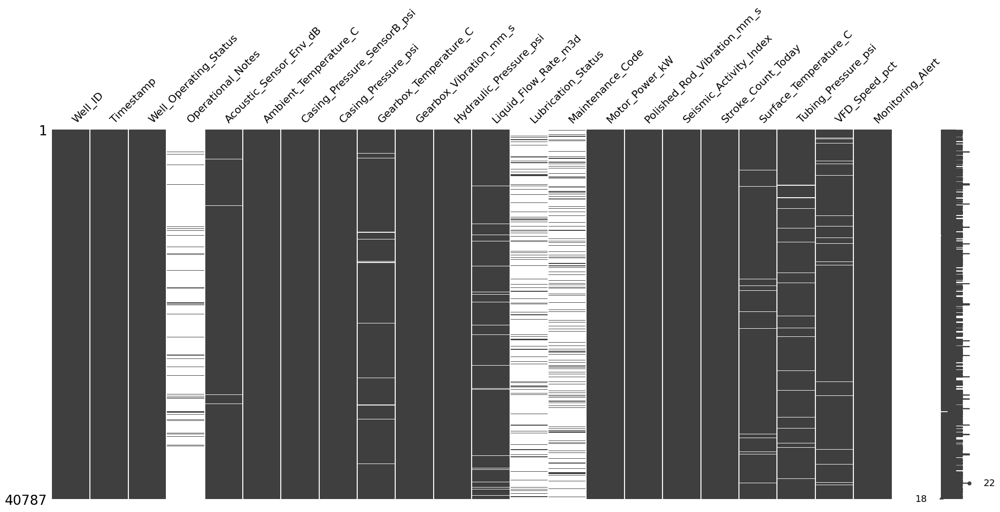

In [9]:
#Check how the missing data looks like
missingno.matrix(train_df)

Observing the missing data. It seems that Operational Notes were only made when it detected an issue in hte system. Similarly Maintenance codes were only generated at the time of maintenance. Lubrication Status was check in certain time intervals and was reported when it was done. The missing data in sensors is sparse and can be filled using interpolation.

In [10]:
#Check the number of unique values in the text/categorial columns
Non_numeric_columns = ['Well_ID', 'Well_Operating_Status','Operational_Notes', 'Lubrication_Status','Maintenance_Code','Monitoring_Alert']
print(train_df['Well_ID'].value_counts(dropna=True))
print(train_df['Well_Operating_Status'].value_counts(dropna=True))
print(train_df['Operational_Notes'].value_counts(dropna=True))
print(train_df['Lubrication_Status'].value_counts(dropna=True))
print(train_df['Maintenance_Code'].value_counts(dropna=True))
print(train_df['Monitoring_Alert'].value_counts(dropna=True))

Well_ID
101    40787
Name: count, dtype: int64
Well_Operating_Status
Operating      40192
Standby          344
Maintenance      188
Startup           63
Name: count, dtype: int64
Operational_Notes
Polished rod load erratic         122
Pressure spike tubing             114
Stuffing box leak                 110
Gas interference suspected        104
Possible rod parting              102
High motor amps                    98
High vibration gearbox             93
Flow rate drop                     89
Fluid pound detected               88
Temp anomaly gearbox               87
Stroke rate steady                 58
Pressures stable                   57
Flow consistent                    56
Parameters logged                  55
Weather condition normal           53
Well shut-in - waiting orders      50
Well shut-in - surface repair      50
Nominal operation                  50
Waiting on flowline                49
Well shut-in - low price           49
Routine check by operator          47
Monit

There is only one Well_ID. Well_Operating_Status is a Categorical column with four categories. Lubrication Status is a Categorical column with two categories. Maintenance Code is a Categorical Column. Monitoring_Alert is a Categorical column with two categories. Operational_Notes is a text column.

In [11]:
#Convert Categorical columns as categories
train_df['Well_Operating_Status'] = train_df['Well_Operating_Status'].astype('category')
train_df['Lubrication_Status'] = train_df['Lubrication_Status'].astype('category')
train_df['Maintenance_Code'] = train_df['Maintenance_Code'].astype('category')
train_df['Monitoring_Alert'] = train_df['Monitoring_Alert'].astype('category')
train_df['Well_ID'] = train_df['Well_ID'].astype('category')

In [12]:
#Check the new data types
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40787 entries, 0 to 40786
Data columns (total 22 columns):
 #   Column                       Non-Null Count  Dtype   
---  ------                       --------------  -----   
 0   Well_ID                      40787 non-null  category
 1   Timestamp                    40787 non-null  object  
 2   Well_Operating_Status        40787 non-null  category
 3   Operational_Notes            1841 non-null   object  
 4   Acoustic_Sensor_Env_dB       40377 non-null  float64 
 5   Ambient_Temperature_C        40787 non-null  float64 
 6   Casing_Pressure_SensorB_psi  40787 non-null  float64 
 7   Casing_Pressure_psi          40787 non-null  float64 
 8   Gearbox_Temperature_C        39981 non-null  float64 
 9   Gearbox_Vibration_mm_s       40787 non-null  float64 
 10  Hydraulic_Pressure_psi       40787 non-null  float64 
 11  Liquid_Flow_Rate_m3d         39560 non-null  float64 
 12  Lubrication_Status           4009 non-null   category
 13  M

In [13]:
#Convert the Timestamp to a datetime format
train_df['Timestamp'] = pd.to_datetime(train_df['Timestamp'])
#Check the new data types
print(train_df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40787 entries, 0 to 40786
Data columns (total 22 columns):
 #   Column                       Non-Null Count  Dtype         
---  ------                       --------------  -----         
 0   Well_ID                      40787 non-null  category      
 1   Timestamp                    40787 non-null  datetime64[ns]
 2   Well_Operating_Status        40787 non-null  category      
 3   Operational_Notes            1841 non-null   object        
 4   Acoustic_Sensor_Env_dB       40377 non-null  float64       
 5   Ambient_Temperature_C        40787 non-null  float64       
 6   Casing_Pressure_SensorB_psi  40787 non-null  float64       
 7   Casing_Pressure_psi          40787 non-null  float64       
 8   Gearbox_Temperature_C        39981 non-null  float64       
 9   Gearbox_Vibration_mm_s       40787 non-null  float64       
 10  Hydraulic_Pressure_psi       40787 non-null  float64       
 11  Liquid_Flow_Rate_m3d         39560 non-nu

In [14]:
#Check the statistics of the numerical columns to look for outliers
print(train_df.describe())

                           Timestamp  Acoustic_Sensor_Env_dB  \
count                          40787            40377.000000   
mean   2023-05-27 00:28:02.639076352               45.032760   
min              2023-01-01 00:00:00               27.446367   
25%              2023-03-15 01:55:00               42.347761   
50%              2023-05-27 03:20:00               45.050711   
75%              2023-08-07 23:45:00               47.746034   
max              2023-10-19 22:50:00               64.470617   
std                              NaN                4.008191   

       Ambient_Temperature_C  Casing_Pressure_SensorB_psi  \
count           40787.000000                 40787.000000   
mean               16.649570                    52.017213   
min                -7.482692                    37.762732   
25%                 6.072449                    50.708179   
50%                14.810344                    52.035401   
75%                26.042869                    53.363072

There are few columns with negative values such as Hydraulic_Pressure_psi, Liquid_Flow_Rate_m3d, VFD_Speed_pct, Ambient_Temperature_C. We will explore the data in these columns further.

In [15]:
# This shows counts of unique combinations across specified columns
columns_to_count = ['Well_Operating_Status', 'Lubrication_Status', 'Monitoring_Alert']
train_df[columns_to_count].value_counts()

Well_Operating_Status  Lubrication_Status  Monitoring_Alert
Operating              OK                  0                   3228
                       Low                 0                    382
                       OK                  1                    337
                       Low                 1                     46
Standby                OK                  0                     16
Name: count, dtype: int64

In [16]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

def plot_sensors(df, height_per_sensor=250):
    """
    Plot each column of df in its own subplot (shared x-axis).

    Parameters
    ----------
    df : pandas.DataFrame
        DateTimeIndex + one numeric column per sensor.
    height_per_sensor : int, optional
        Pixel height allotted to each subplot (default 250).

    Returns
    -------
    fig : plotly.graph_objects.Figure
    """
    n = len(df.columns)                     # <— works for any “n sensors”
    fig = make_subplots(
        rows=n,
        cols=1,
        shared_xaxes=True,
        vertical_spacing=0.015              # tighter spacing
    )

    for i, col in enumerate(df.columns, start=1):
        fig.add_trace(
            go.Scatter(
                x=df.index,
                y=df[col],
                name=col,
                line_width=1
            ),
            row=i,
            col=1
        )
        fig.update_yaxes(title_text=col, row=i, col=1)

    fig.update_layout(
        height=max(400, n * height_per_sensor),   # scale canvas height
        showlegend=False,
        hovermode="x unified",
        margin=dict(t=30, b=30, l=60, r=20)
    )
    return fig

# ------- USAGE -------
plot_df = train_df.copy()
plot_df = plot_df.set_index('Timestamp').sort_index()


fig = plot_sensors(plot_df)      # df = your cleaned DataFrame
fig.show()


 Based on the Monitoring Alerts from the time series data, we can tell, the following parameters had limited role to play [VFD_Speed_pct, Tubing_Pressure_psi, Stroke_Count_Today, Seismic_Activity_Index. In addition, the Well_Operating_Status needs to be 'Operating' for Monitoring_Alert to be one. Visually inspecting the graph, the health monitor is one, is correlated to Surface temperature increase, Motor_Power_KW increase, Gearbox Temperature increase, hydraulic pressure dropping(sometimes), Operational Notes must be present.

Based on this observations, I plan to fill the missing data in Operator Notes as 'Normal'. I will fill missing data in Maintenance codes as '000'

/var/folders/04/2jgztr016nbbjm90z313xb940000gn/T/ipykernel_8141/2215817235.py:18: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




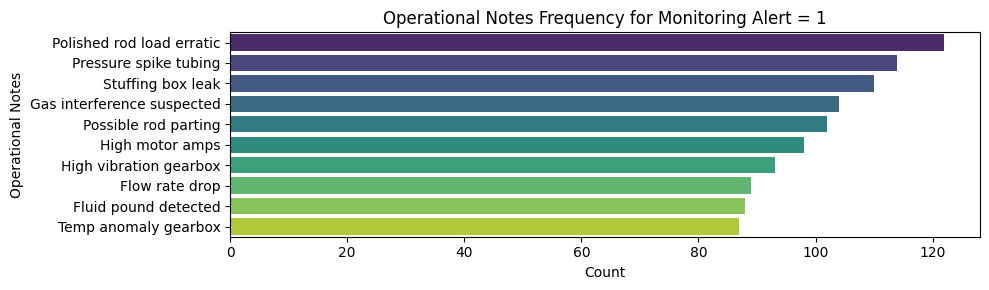

In [33]:
#Find out all the Operational Notes when the Monitoring_Alert was one
import matplotlib.pyplot as plt
import seaborn as sns

# 1️⃣ Compute value counts of Operational_Notes where Monitoring_Alert == 1
vc = (
    train_df[train_df['Monitoring_Alert'] == 1]['Operational_Notes']
    .value_counts()
    .reset_index()
)
vc.columns = ['Operational_Notes', 'count']

# Optional: if there are many categories, you can take the top N
# vc = vc.head(10)

# 2️⃣ Plot as a horizontal barplot
plt.figure(figsize=(10, 3))
sns.barplot(
    data=vc,
    x='count',
    y='Operational_Notes',
    palette='viridis'
)

plt.title('Operational Notes Frequency for Monitoring Alert = 1')
plt.xlabel('Count')
plt.ylabel('Operational Notes')
plt.tight_layout()
plt.show()

These are the various operational notes that were recorded when the Monitor Health Alert was flagged. All of the issues listed above are encountered almost similar proportion in this time series dataset.

In [39]:
# Set Timestamp as index
df = train_df.copy()
df.set_index('Timestamp', inplace=True)
df.sort_index(inplace=True)

In [45]:
# 1️⃣  Identify contiguous runs of Monitoring_Alert changes
df['run_id'] = (
    df['Monitoring_Alert']
      .ne(df['Monitoring_Alert'].shift())
      .cumsum()
)

# 2️⃣  Group only the “alert == 1” periods
runs = df[df['Monitoring_Alert'] == 1].groupby('run_id')

alert_periods = (
    runs
    .apply(lambda grp: pd.Series({
        'start':            grp.index[0],
        'end':              grp.index[-1],
        'duration':         grp.index[-1] - grp.index[0],
        'Operator_Notes':   '; '.join(
                                grp['Operational_Notes']
                                  .dropna()
                                  .astype(str)
                                  .unique()
                            ),
        'Maintenance_Code': '; '.join(
                                grp['Maintenance_Code']
                                  .dropna()
                                  .astype(str)
                                  .unique()
                            )
    }))
    .reset_index(drop=True)
)

display(alert_periods)


/var/folders/04/2jgztr016nbbjm90z313xb940000gn/T/ipykernel_8141/2482110934.py:13: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



,start,end,duration,Operator_Notes,Maintenance_Code
0,2023-01-18 08:40:00,2023-01-19 01:10:00,0 days 16:30:00,High motor amps; Stuffing box leak; Possible r...,610.0; 501.0; 502.0; 999.0
1,2023-02-11 16:00:00,2023-02-14 02:10:00,2 days 10:10:00,Gas interference suspected; Pressure spike tub...,502.0; 999.0; 610.0; 501.0; 705.0
2,2023-03-07 23:20:00,2023-03-09 00:10:00,1 days 00:50:00,High vibration gearbox; Possible rod parting; ...,501.0; 705.0; 610.0; 502.0; 999.0
3,2023-03-18 09:20:00,2023-03-21 12:10:00,3 days 02:50:00,Temp anomaly gearbox; Fluid pound detected; St...,501.0; 502.0; 610.0; 705.0; 999.0
4,2023-04-08 05:20:00,2023-04-10 07:10:00,2 days 01:50:00,High motor amps; Possible rod parting; Fluid p...,610.0; 502.0; 501.0; 999.0; 705.0
5,2023-05-06 00:00:00,2023-05-06 13:10:00,0 days 13:10:00,High motor amps; High vibration gearbox; Possi...,502.0; 705.0; 501.0; 610.0
6,2023-05-16 10:00:00,2023-05-19 21:10:00,3 days 11:10:00,Possible rod parting; High motor amps; Stuffin...,501.0; 705.0; 502.0; 999.0; 610.0
7,2023-06-16 16:00:00,2023-06-18 01:10:00,1 days 09:10:00,Polished rod load erratic; Fluid pound detecte...,610.0; 501.0; 502.0; 999.0; 705.0
8,2023-06-27 02:00:00,2023-06-28 19:30:00,1 days 17:30:00,Pressure spike tubing; Gas interference suspec...,501.0; 502.0; 705.0; 610.0; 999.0
9,2023-07-28 08:00:00,2023-08-02 04:30:00,4 days 20:30:00,Temp anomaly gearbox; Flow rate drop; Pressure...,502.0; 501.0; 610.0; 999.0; 705.0


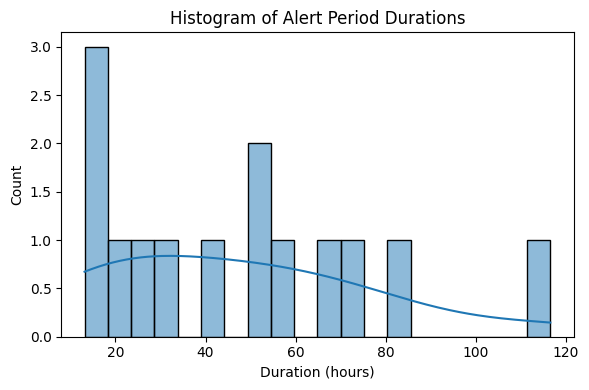

In [49]:
import seaborn as sns
import matplotlib.pyplot as plt

# ensure alert_periods['duration_h'] exists
alert_periods['duration_h'] = alert_periods['duration'].dt.total_seconds() / 3600

# ───────────────────────────────────────────────────
# 1) Histogram of alert durations
# ───────────────────────────────────────────────────
plt.figure(figsize=(6, 4))
sns.histplot(
    data=alert_periods,
    x='duration_h',
    bins=20,
    kde=True
)
plt.xlabel("Duration (hours)")
plt.title("Histogram of Alert Period Durations")
plt.tight_layout()
plt.show()


In [53]:
bins  = [0, 24, 48, 72, 96, alert_periods['duration_h'].max()]
labels = ['<24h','24–48h','48–72h','72–96h','>96h']

alert_periods['dur_group'] = pd.cut(
    alert_periods['duration_h'],
    bins=bins,
    labels=labels,
    include_lowest=True
)




# For each group, list the top-N most frequent notes
top_notes = {}
for grp, dfg in alert_periods.groupby('dur_group'):
    vc = dfg['Operator_Notes'].str.split('; ').explode().value_counts().head(5)
    top_notes[grp] = vc

# Display as a DataFrame
top_notes_df = pd.DataFrame(top_notes).fillna(0).astype(int)
print(top_notes_df)


                            <24h  24–48h  48–72h  72–96h  >96h
Operator_Notes                                                
Flow rate drop                 0       3       0       0     1
Fluid pound detected           4       0       0       2     0
Gas interference suspected     4       3       4       0     0
High motor amps                4       0       4       2     0
High vibration gearbox         4       3       4       0     1
Polished rod load erratic      4       3       0       0     1
Possible rod parting           0       3       0       2     0
Pressure spike tubing          0       0       4       0     1
Stuffing box leak              0       0       4       2     0
Temp anomaly gearbox           0       0       0       2     1


/var/folders/04/2jgztr016nbbjm90z313xb940000gn/T/ipykernel_8141/1952542517.py:16: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



This shows us, which problems can be fixed in less than a day the ones which take much longer to fix.
1. The problems that may take longer than 2 days seem to be Pressure spike tubing, Stuffing box leak, Temp anomaly gearbox.

In [57]:
# Estimate the time between the alerts (The time when the system was healthy)
# assumes alert_periods is sorted by start
alert_periods = alert_periods.sort_values('start').reset_index(drop=True)

# shift end times down to get the previous end
alert_periods['prev_end'] = alert_periods['end'].shift()
alert_periods['uptime_days'] = (
    alert_periods['start'] - alert_periods['prev_end']
).dt.total_seconds() / 3600/24

print(alert_periods[['start','prev_end','uptime_days']])


                 start            prev_end  uptime_days
0  2023-01-18 08:40:00                 NaT          NaN
1  2023-02-11 16:00:00 2023-01-19 01:10:00    23.618056
2  2023-03-07 23:20:00 2023-02-14 02:10:00    21.881944
3  2023-03-18 09:20:00 2023-03-09 00:10:00     9.381944
4  2023-04-08 05:20:00 2023-03-21 12:10:00    17.715278
5  2023-05-06 00:00:00 2023-04-10 07:10:00    25.701389
6  2023-05-16 10:00:00 2023-05-06 13:10:00     9.868056
7  2023-06-16 16:00:00 2023-05-19 21:10:00    27.784722
8  2023-06-27 02:00:00 2023-06-18 01:10:00     9.034722
9  2023-07-28 08:00:00 2023-06-28 19:30:00    29.520833
10 2023-08-18 04:00:00 2023-08-02 04:30:00    15.979167
11 2023-08-28 14:00:00 2023-08-18 23:50:00     9.590278
12 2023-09-21 21:20:00 2023-08-31 08:30:00    21.534722
13 2023-10-05 18:40:00 2023-09-22 12:10:00    13.270833


/var/folders/04/2jgztr016nbbjm90z313xb940000gn/T/ipykernel_8141/1063375875.py:12: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




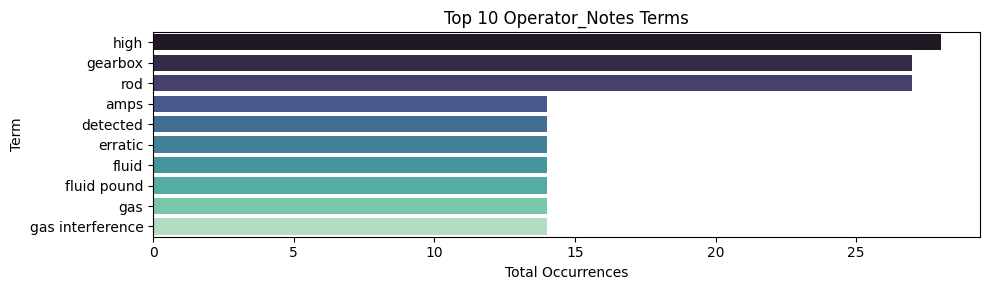

In [65]:
from sklearn.feature_extraction.text import CountVectorizer

cv = CountVectorizer(stop_words='english', ngram_range=(1,2), min_df=2)
X = cv.fit_transform(alert_periods['Operator_Notes'].fillna(''))
top_terms = pd.Series(X.toarray().sum(axis=0), index=cv.get_feature_names_out())
# Prepare for plotting
plot_df = top_terms.nlargest(10).reset_index()
plot_df.columns = ['term','count']

# Plot
plt.figure(figsize=(10,3))
sns.barplot(
    data=plot_df,
    x='count',
    y='term',
    palette='mako'
)
plt.title("Top 10 Operator_Notes Terms")
plt.xlabel("Total Occurrences")
plt.ylabel("Term")
plt.tight_layout()
plt.show()


This frequency of words in Operational Notes during Alerts, shows that majority of the time it was related to gearbox and rod issues followed by fluid pound and gas interference.

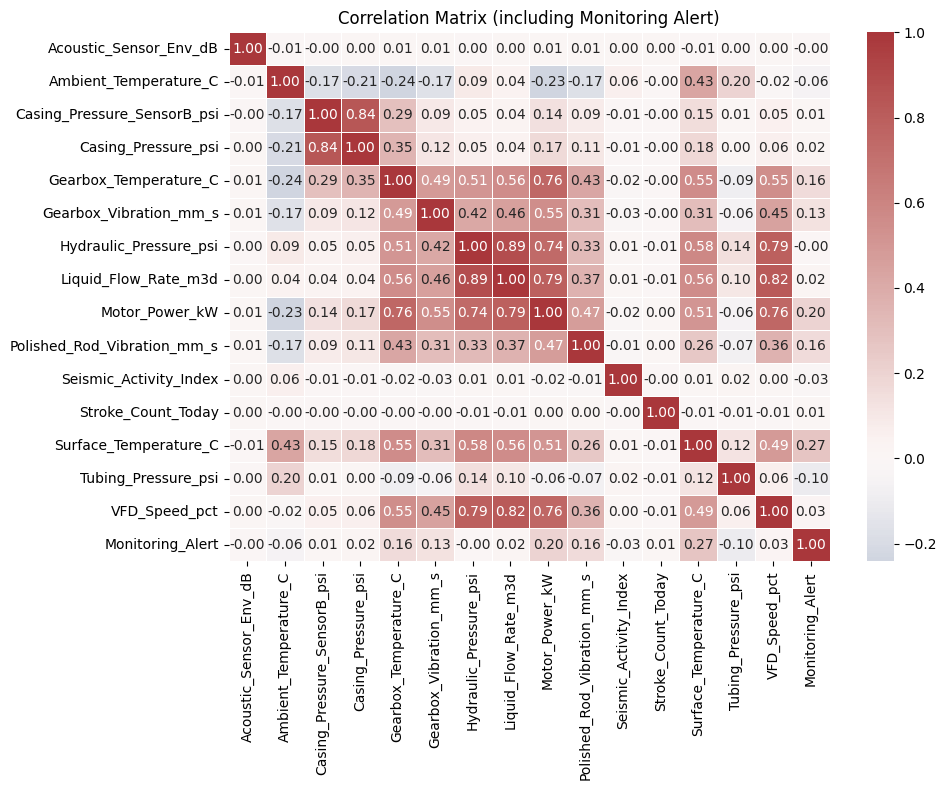

In [30]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt


target_col = 'Monitoring_Alert'

train_df[target_col] = train_df[target_col].astype('category')
y_codes = train_df[target_col].cat.codes.rename('Monitoring_Alert')

# Select numeric feature columns, dropping the target if it’s in there
num_cols = train_df.select_dtypes(include=[np.number]).columns.tolist()
if target_col in num_cols:
    num_cols.remove(target_col)

# Build a new DataFrame of only numeric features + the target code
df_enc = pd.concat([
    train_df[num_cols],
    y_codes
], axis=1)

# Compute the full correlation matrix
corr_mat = df_enc.corr()

# Plot as a heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(
    corr_mat,
    cmap='vlag',
    center=0,
    annot=True,
    fmt=".2f",
    linewidths=0.5
)
plt.title("Correlation Matrix (including Monitoring Alert)")
plt.tight_layout()
plt.show()


In the above correlation matrix for sensor data, we see the following correlations
1. Casing_Pressure_psi and Casing_Pressure_SensorB_psi (0.84)
2. Ambient_Temperature and Surface Temperature (0.43)
3. Motor Power : Gearbox Temperature, Hydraulic Pressure, Liquid Flow Rate, VFD_speed
4. Monitoring_Alert: Surface_Temperature (0.27), Motor Power (0.2), Gearbox_Temperature (0.16). It kind of tells that the indicator is for the motor/gearbox drive train stress and not downhole issues like pump fillage or valves)

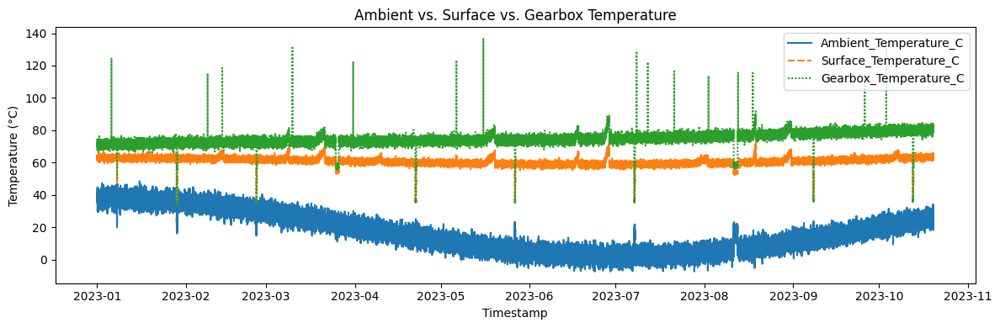

In [70]:
#Analyzing Temperature Sensors
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(12,4))
sns.lineplot(data=df[['Ambient_Temperature_C',
                      'Surface_Temperature_C',
                      'Gearbox_Temperature_C']])
plt.ylabel("Temperature (°C)")
plt.title("Ambient vs. Surface vs. Gearbox Temperature")
plt.legend(title="")
plt.tight_layout()
plt.show()


The temperature sensors indicate, Gearbox Temperature is highest followed by Surface Temperature and Ambient Temperature. The temperature difference between Gearbox Temperature and Surface Temperature seem to gradually increasing with time.

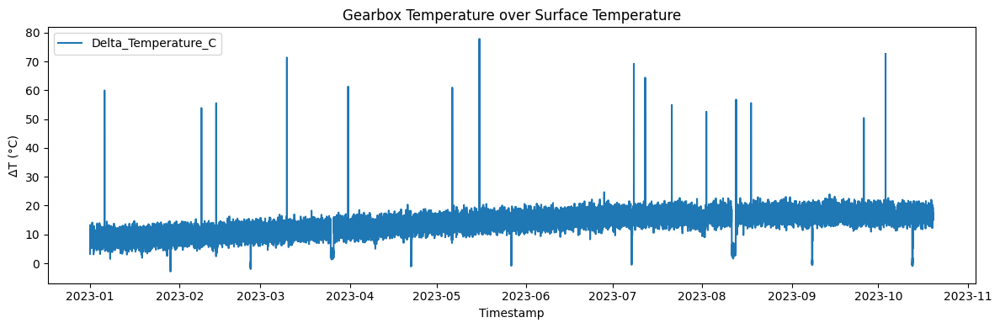

In [72]:
df['Delta_Temperature_C'] = df['Gearbox_Temperature_C'] - df['Surface_Temperature_C']

plt.figure(figsize=(12,4))
sns.lineplot(data=df[['Delta_Temperature_C',]])
plt.ylabel("ΔT (°C)")
plt.title("Gearbox Temperature over Surface Temperature")
plt.tight_layout()
plt.show()


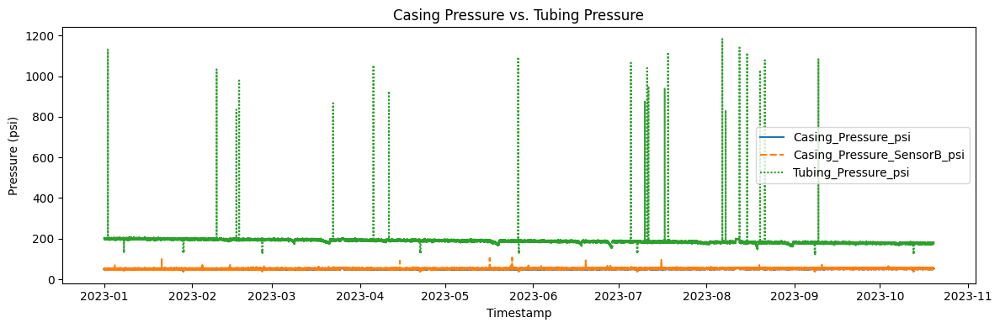

In [76]:
#Analyzing Pressure Sensors
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(12,4))
sns.lineplot(data=df[['Casing_Pressure_psi',
                      'Casing_Pressure_SensorB_psi',
                      'Tubing_Pressure_psi']])
plt.ylabel("Pressure (psi)")
plt.title("Casing Pressure vs. Tubing Pressure")
plt.tight_layout()
plt.show()